<a href="https://colab.research.google.com/github/Firdausfatihul/automated_trim_video/blob/main/main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import subprocess
import sys

In [2]:
def install_ffmpeg():
  subprocess.run(
      [
          'apt-get',
          'update'
      ],
      check=True,
      stdout=subprocess.PIPE,
      stderr=subprocess.PIPE
  )
  subprocess.run(
      [
          'apt-get',
          'install',
          '-y',
          'ffmpeg'
      ],
      check=True,
      stdout=subprocess.PIPE,
      stderr=subprocess.PIPE
  )

In [3]:
install_ffmpeg()

In [4]:
result = subprocess.run(['ffmpeg', '-version'], check=True, capture_output=True, text=True)

In [5]:
result

CompletedProcess(args=['ffmpeg', '-version'], returncode=0, stdout='ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers\nbuilt with gcc 11 (Ubuntu 11.2.0-19ubuntu1)\nconfiguration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwo

In [6]:
import os
import gdown

In [7]:
google_drive = '1iIQE7_oVDF0OzSzqxvVuruSPCggmd5z1'

In [8]:
output_file = 'downloaded.mp4'

In [9]:
uploaded_file_name = None

In [10]:
try:
  if output_file:
    downloaded_path = gdown.download(
        id=google_drive,
        output=output_file,
        quiet=False
    )
  if downloaded_path and os.path.exists(downloaded_path):
        uploaded_file_name = downloaded_path # Store the path of the downloaded file
        print(f'\nSuccessfully downloaded video as: "{uploaded_file_name}"')
  else:
        print("\nDownload may have failed or the file was not found after the download attempt.")
        if downloaded_path is None:
          print("gdown.download returned None, which often indicates an issue with the file ID, permissions, or the file itself on Google Drive.")

except Exception as e:
  print(f"An error occurred: {e}")

Downloading...
From (original): https://drive.google.com/uc?id=1iIQE7_oVDF0OzSzqxvVuruSPCggmd5z1
From (redirected): https://drive.google.com/uc?id=1iIQE7_oVDF0OzSzqxvVuruSPCggmd5z1&confirm=t&uuid=b67b3e8b-650b-466a-a3ef-42ce4c089c15
To: /content/downloaded.mp4
100%|██████████| 389M/389M [00:09<00:00, 41.0MB/s]


Successfully downloaded video as: "downloaded.mp4"


In [11]:
output_image_path = 'first_frame.png'

In [12]:
command = [
    'ffmpeg',
    '-i', uploaded_file_name,
    '-vframes', '1',
    '-q:v', '2',
    '-an',
    output_image_path,
    '-y'
]

In [13]:
try:
  result = subprocess.run(
      command,
      check=True,
      capture_output=True,
      text=True
  )
  print("First frame success")
  if result.stderr:
    print(f"FFmpeg messages:\n {result.stderr}")
except subprocess.CalledProcessError as e:
  print("Error during FFmpeg execution:")
  print("Return code:", e.returncode)
  print("Output (stdout):", e.stdout)
  print("Error (stderr):", e.stderr)
except FileNotFoundError:
  print(f"Error: Could not find the input video file '{uploaded_file_name}'. "
  "Ensure the upload in Cell 2 was successful and the filename is correct.")

First frame success
FFmpeg messages:
 ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --e

In [14]:
from IPython.display import Image, display


In [15]:
image_to_display = "first_frame.png"


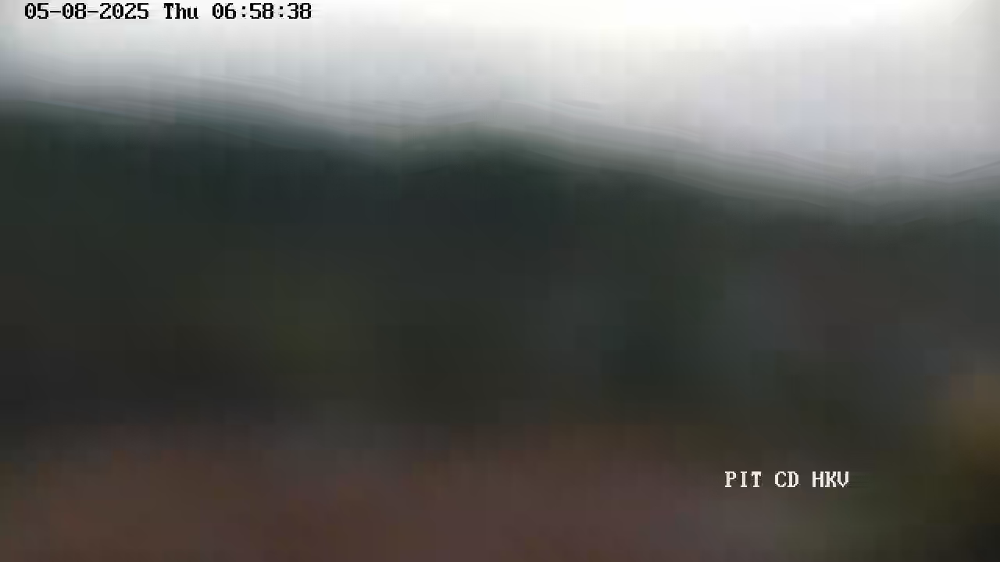

In [16]:
display(Image(filename=image_to_display))

In [17]:
def time_to_seconds(time_str):
  try:
    h, m, s = map(int, time_str.split(':'))
    return h * 3600 + m * 60 + s
  except ValueError:
    print(
        f"Error invalid time format '{time_str}'"
    )
    return None

In [18]:
t_ref_displayed_string = "06:58:38"
t_target_start_displayed_string = "07:21:20"
t_target_end_displayed_string = "07:21:50"

In [19]:
t_ref_seconds = time_to_seconds(t_ref_displayed_string)
t_target_start_seconds = time_to_seconds(t_target_start_displayed_string)
t_target_end_seconds = time_to_seconds(t_target_end_displayed_string)

In [20]:
playback_start_cut_seconds = t_target_start_seconds - t_ref_seconds
playback_end_cut_seconds = t_target_end_seconds - t_ref_seconds


In [21]:
print(f"Reference time from first frame (T_ref): {t_ref_displayed_string} ({t_ref_seconds}s)")
print(f"Target displayed start time: {t_target_start_displayed_string} ({t_target_start_seconds}s)")
print(f"Target displayed end time: {t_target_end_displayed_string} ({t_target_end_seconds}s)")
print("---")
print(f"Calculated FFmpeg start time (-ss): {playback_start_cut_seconds} seconds")
print(f"Calculated FFmpeg end time (-to): {playback_end_cut_seconds} seconds")
print("---")

Reference time from first frame (T_ref): 06:58:38 (25118s)
Target displayed start time: 07:21:20 (26480s)
Target displayed end time: 07:21:50 (26510s)
---
Calculated FFmpeg start time (-ss): 1362 seconds
Calculated FFmpeg end time (-to): 1392 seconds
---


In [22]:
base, ext = os.path.splitext(
    os.path.basename(
        uploaded_file_name
    )
)

In [23]:
output_trimmed_video_filename = f"{base}_trimmed_{t_target_start_displayed_string.replace(':','')}_{t_target_end_displayed_string.replace(':','')}{ext}"
output_trimmed_video_filename = output_trimmed_video_filename.replace(":", "-") # Ensure colons are not in filename


In [25]:
def trim_video(trim_command):
  try:
    result = subprocess.run(
      trim_command,
      check=True,
      capture_output=True,
      text=True
    )
    if result.stderr:
      print("FFmpeg messages:\n", result.stderr)
  except subprocess.CalledProcessError as e:
    print("Error during FFmpeg execution:")
    print("Return code:", e.returncode)
    print("Output (stdout):", e.stdout)
    print("Error (stderr):", e.stderr)

In [26]:
trim_video(trim_command)

FFmpeg messages:
 ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --en

In [27]:
from base64 import b64encode
from IPython.display import HTML

In [28]:
mp4 = open(output_trimmed_video_filename, 'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

print(f"Displaying video: {output_trimmed_video_filename}")
display(HTML(f"""
<video width=600 controls autoplay>
<source src="{data_url}" type="video/mp4">
Your browser does not support the video tag.
</video>
"""))

Displaying video: downloaded_trimmed_072120_072150.mp4


In [30]:
from google.colab import files
import pandas as pd

In [31]:
uploaded_csv = files.upload()

Saving List Video Trim - Magang - Sheet1.csv to List Video Trim - Magang - Sheet1.csv


In [32]:
csv_filename = list(uploaded_csv.keys())[0]


In [33]:
df_check = pd.read_csv(csv_filename)

In [34]:
df_check

,No,Defect,Priority,Link Video Magang,Timestamp,PIC Trimming,Trimming,Link Trim Video
0,1,HD Tidak Terdeteksi pada notif,P2,NaN,11:28:50 sd 11:29:30,Ridho,YES,NaN
1,2,HD Tidak Terdeteksi pada notif,P2,NaN,10:26:30 sd 10:27:00,Ridho,YES,NaN
2,3,HD Tidak Terdeteksi pada notif,P2,NaN,10:23:15 sd 10:23:40,Ridho,YES,NaN
3,4,HD Tidak Terdeteksi pada notif,P2,NaN,10:23:15 sd 10:23:40,Ridho,YES,NaN
4,5,HD Tidak Terdeteksi pada notif,P2,NaN,10:43:40 sd 10:44:50,Ridho,YES,NaN
...,...,...,...,...,...,...,...,...
133,134,Pada HD yang berdekatan terdapat HD yang tidak...,P1,NaN,15:13:20 sd 15:13:35,Ridho,YES,NaN
134,135,Objek lain terdeteksi sebagai HD,P2,TOP_SOIL_PIT_J_NVR_J_NVR_J_20250520110429_20...,12:30:25 sd 12:30:40,Rasyid,NaN,NaN
135,136,Objek lain terdeteksi sebagai HD,P2,TOP_SOIL_PIT_J_NVR_J_NVR_J_20250520110429_202...,11:21:50 sd 11:22:00,Rasyid,NaN,NaN
136,137,Objek lain terdeteksi sebagai HD,P2,TOP_SOIL_PIT_J_NVR_J_NVR_J_20250520100000_2025...,10:49:40 sd 10:49:55,Rasyid,NaN,NaN


In [35]:
firdaus_tasks_df = df_check[
            (df_check['PIC Trimming'].str.lower() == 'firdaus') &
            (df_check['Link Video Magang'].str.lower() != 'nan') & (df_check['Link Video Magang'] != '') &
            (df_check['Timestamp'].str.lower() != 'nan') & (df_check['Timestamp'] != '') & (df_check['Timestamp'].str.contains('sd', case=False))
        ].copy()

In [36]:
firdaus_tasks_df

,No,Defect,Priority,Link Video Magang,Timestamp,PIC Trimming,Trimming,Link Trim Video
11,12,HD Tidak Terdeteksi pada notif,P2,PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_2...,07:21:20 sd 07:21:50,Firdaus,NaN,NaN
12,13,HD Tidak Terdeteksi pada notif,P2,PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_2...,07:21:20 sd 07:21:50,Firdaus,NaN,NaN
13,14,HD Tidak Terdeteksi pada notif,P2,PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_2...,07:16:20 sd 07:16:50,Firdaus,NaN,NaN
14,15,HD Tidak Terdeteksi pada notif,P2,PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_2...,07:14:20 sd 07:14:50,Firdaus,NaN,NaN
15,16,HD Tidak Terdeteksi pada notif,P2,PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_2...,07:12:00 sd 07:12:50,Firdaus,NaN,NaN
16,17,HD Tidak Terdeteksi pada notif,P2,PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508060001_2...,06:46:00 sd 06:46:50,Firdaus,NaN,NaN
17,18,HD Tidak Terdeteksi pada notif,P2,PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508060001_2...,06:46:00 sd 06:46:50,Firdaus,NaN,NaN
18,19,HD Tidak Terdeteksi pada notif,P2,PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508060001_2...,06:06:00 sd 06:06:30,Firdaus,NaN,NaN
44,45,HD Tidak Terdeteksi pada notif,P2,PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250509060003_...,06:12:30 sd 06:12:50,Firdaus,NaN,NaN
45,46,HD Tidak Terdeteksi pada notif,P2,PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250509060003_...,06:04:20 sd 06:04:35,Firdaus,NaN,NaN


In [37]:
def find_file_in_drive(filename_to_find, search_base_path="/content/drive/MyDrive"):
    print(f"Searching for '{filename_to_find}' in '{search_base_path}'...")
    for root, dirs, files in os.walk(search_base_path):
        if filename_to_find in files:
            found_path = os.path.join(root, filename_to_find)
            print(f"Found: {found_path}")
            return found_path
    print(f"Warning: File '{filename_to_find}' not found in '{search_base_path}'.")
    return None

In [38]:
def extract_first_frame_from_video(video_path, output_image_name="temp_first_frame.png"):
    if not os.path.exists(video_path):
        print(f"Error: Video file not found at {video_path}", file=sys.stderr)
        return None

    if os.path.exists(output_image_name):
        os.remove(output_image_name)

    command = [
        'ffmpeg', '-i', video_path, '-vframes', '1', '-q:v', '2', '-an', output_image_name, '-y'
    ]
    try:
        subprocess.run(command, check=True, capture_output=True, text=True)
        print(f"First frame extracted to {output_image_name}")
        return output_image_name
    except subprocess.CalledProcessError as e:
        print(f"Error extracting first frame from '{video_path}':\n{e.stderr}", file=sys.stderr)
        return None

In [29]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [40]:
import time

Trimmed videos will be saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus

Starting processing for 20 'Firdaus' tasks...

--- Processing Task 12 ---
Video Filename (from CSV): PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441.mp4
Timestamp String (from CSV): 07:21:20 sd 07:21:50
Searching for 'PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441.mp4' in '/content/drive/MyDrive/Video_bersama'...
Found: /content/drive/MyDrive/Video_bersama/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441.mp4
First frame extracted to temp_first_frame.png
--- Processing Task 12 for PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441.mp4 ---
Video found at: /content/drive/MyDrive/Video_bersama/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441.mp4
Target displayed times from CSV: 07:21:20 sd 07:21:50

VVV --- First Frame of the Video --- VVV


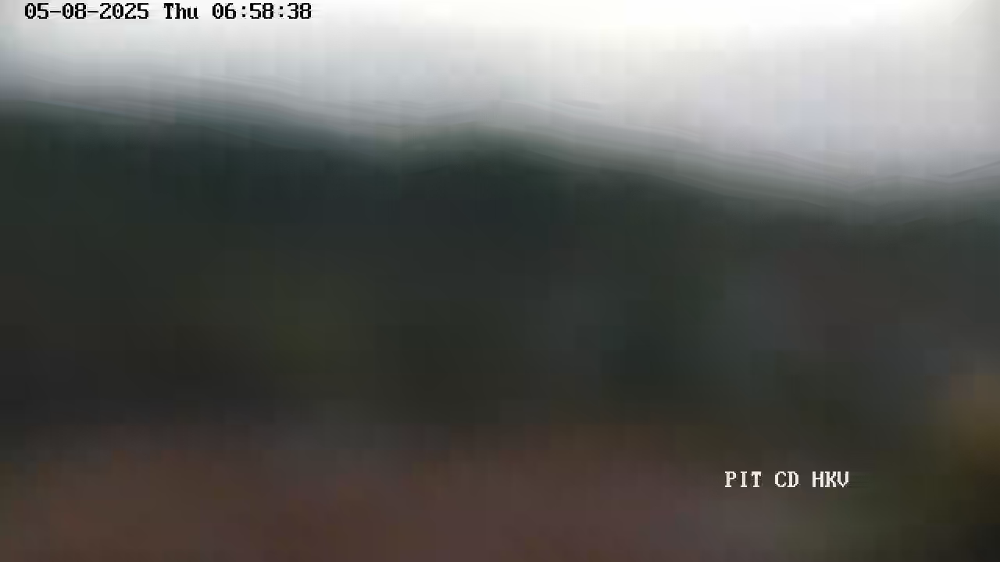

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 06:58:38
  Reference time (T_ref from frame): 06:58:38 (25118s)
  Target Displayed Start (from CSV): 07:21:20 (26480s)
  Target Displayed End (from CSV): 07:21:50 (26510s)
  Calculated FFmpeg start time (-ss): 1362 seconds
  Calculated FFmpeg end time (-to): 1392 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441_TRIM_(12).mp4
FFmpeg command: ffmpeg -ss 1360.5 -i /content/drive/MyDrive/Video_bersama/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441.mp4 -t 31.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441_TRIM_(12).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TA

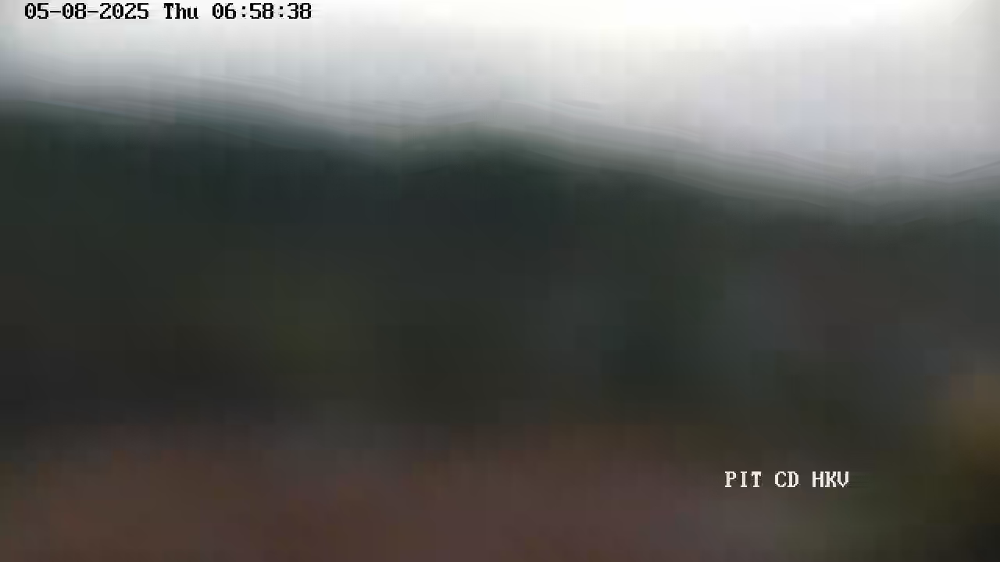

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 06:58:38
  Reference time (T_ref from frame): 06:58:38 (25118s)
  Target Displayed Start (from CSV): 07:21:20 (26480s)
  Target Displayed End (from CSV): 07:21:50 (26510s)
  Calculated FFmpeg start time (-ss): 1362 seconds
  Calculated FFmpeg end time (-to): 1392 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441_TRIM_(13).mp4
FFmpeg command: ffmpeg -ss 1360.5 -i /content/drive/MyDrive/Video_bersama/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441.mp4 -t 31.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441_TRIM_(13).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TA

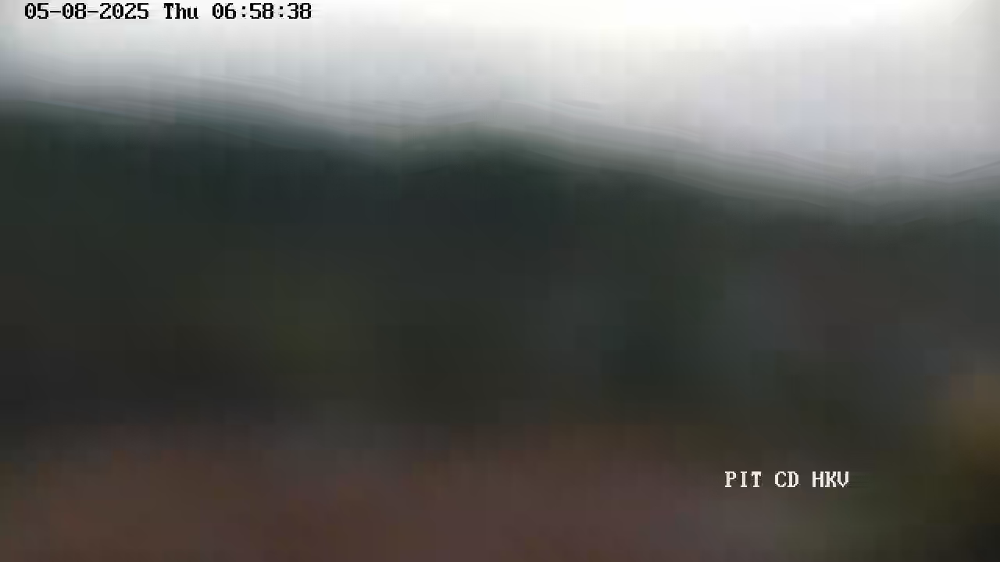

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 06:58:38
  Reference time (T_ref from frame): 06:58:38 (25118s)
  Target Displayed Start (from CSV): 07:16:20 (26180s)
  Target Displayed End (from CSV): 07:16:50 (26210s)
  Calculated FFmpeg start time (-ss): 1062 seconds
  Calculated FFmpeg end time (-to): 1092 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441_TRIM_(14).mp4
FFmpeg command: ffmpeg -ss 1060.5 -i /content/drive/MyDrive/Video_bersama/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441.mp4 -t 31.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441_TRIM_(14).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TA

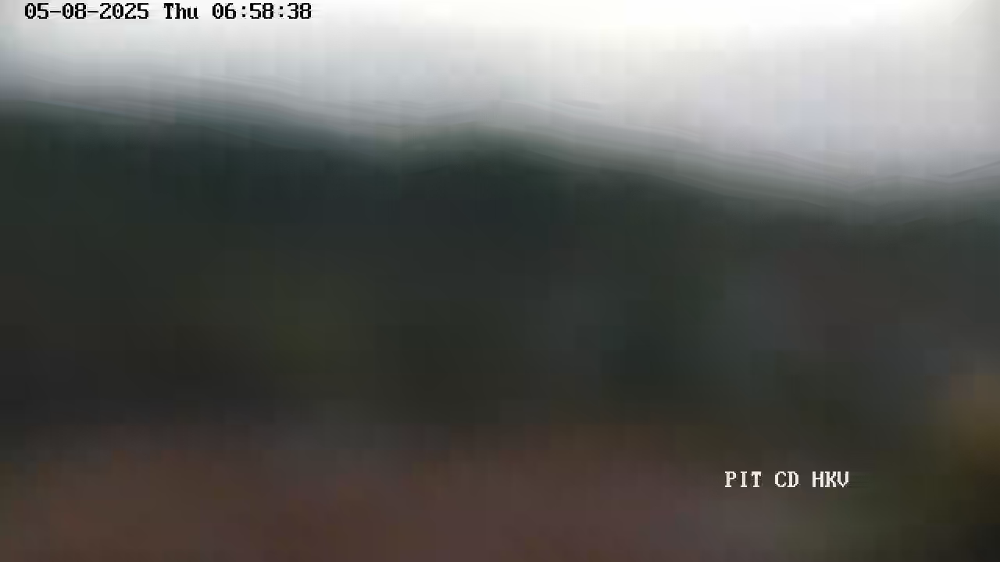

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 06:58:38
  Reference time (T_ref from frame): 06:58:38 (25118s)
  Target Displayed Start (from CSV): 07:14:20 (26060s)
  Target Displayed End (from CSV): 07:14:50 (26090s)
  Calculated FFmpeg start time (-ss): 942 seconds
  Calculated FFmpeg end time (-to): 972 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441_TRIM_(15).mp4
FFmpeg command: ffmpeg -ss 940.5 -i /content/drive/MyDrive/Video_bersama/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441.mp4 -t 31.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441_TRIM_(15).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBA

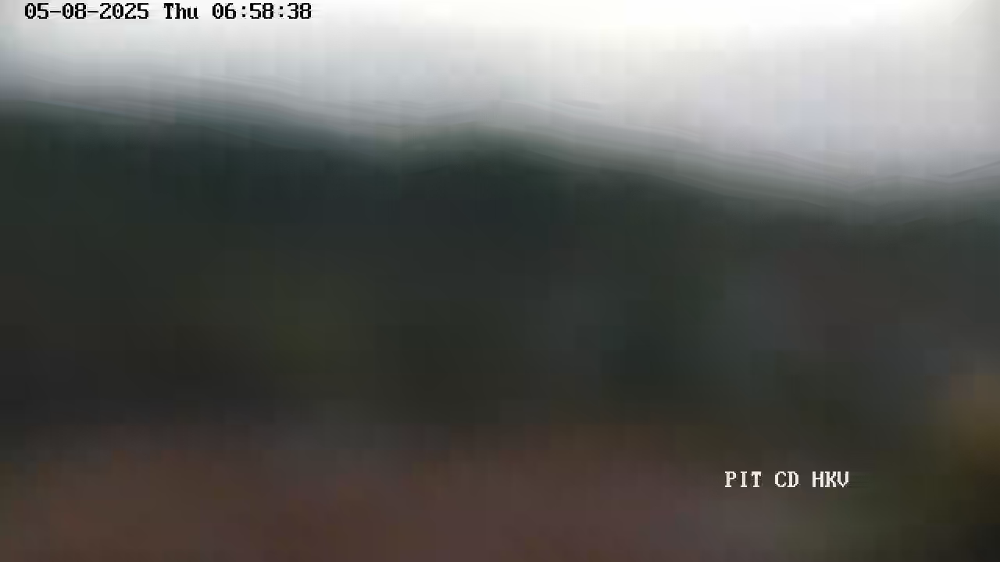

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 06:58:38
  Reference time (T_ref from frame): 06:58:38 (25118s)
  Target Displayed Start (from CSV): 07:12:00 (25920s)
  Target Displayed End (from CSV): 07:12:50 (25970s)
  Calculated FFmpeg start time (-ss): 802 seconds
  Calculated FFmpeg end time (-to): 852 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441_TRIM_(16).mp4
FFmpeg command: ffmpeg -ss 800.5 -i /content/drive/MyDrive/Video_bersama/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441.mp4 -t 51.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508065838_20250508080001_792441_TRIM_(16).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBA

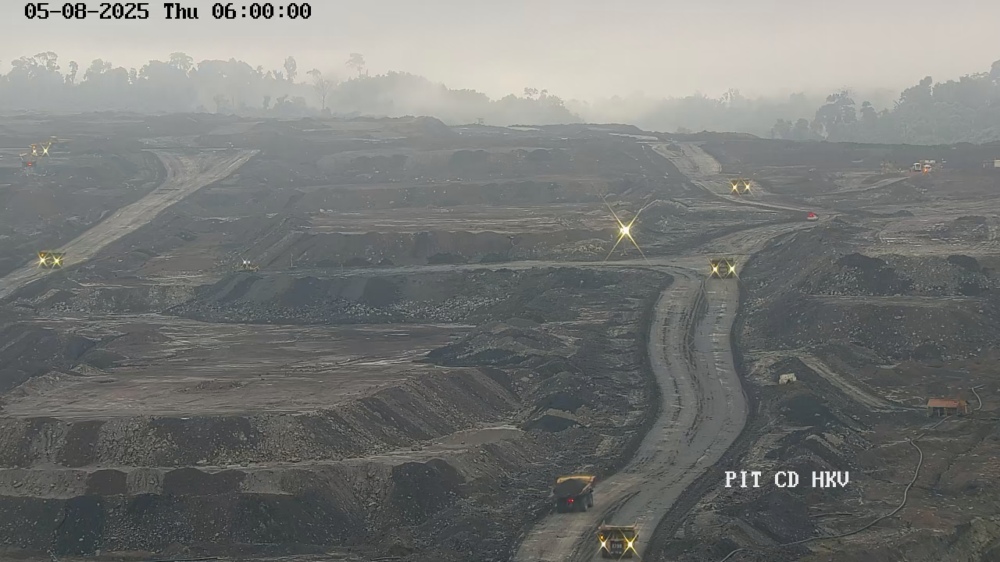

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 06:00:00
  Reference time (T_ref from frame): 06:00:00 (21600s)
  Target Displayed Start (from CSV): 06:46:00 (24360s)
  Target Displayed End (from CSV): 06:46:50 (24410s)
  Calculated FFmpeg start time (-ss): 2760 seconds
  Calculated FFmpeg end time (-to): 2810 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508060001_20250508065549_776619_TRIM_(17).mp4
FFmpeg command: ffmpeg -ss 2758.5 -i /content/drive/MyDrive/Video_bersama/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508060001_20250508065549_776619.mp4 -t 51.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508060001_20250508065549_776619_TRIM_(17).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TA

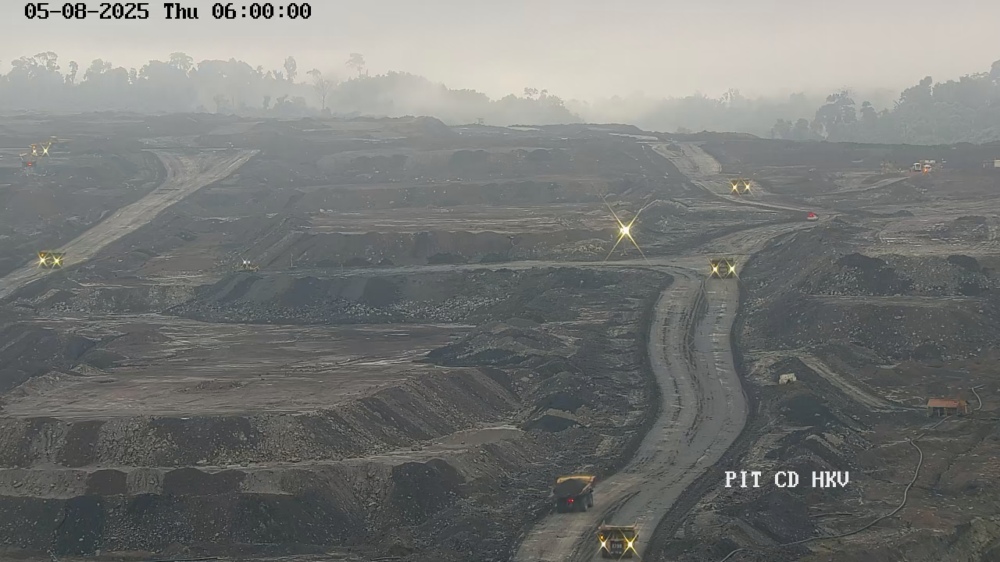

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 06:00:00
  Reference time (T_ref from frame): 06:00:00 (21600s)
  Target Displayed Start (from CSV): 06:46:00 (24360s)
  Target Displayed End (from CSV): 06:46:50 (24410s)
  Calculated FFmpeg start time (-ss): 2760 seconds
  Calculated FFmpeg end time (-to): 2810 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508060001_20250508065549_776619_TRIM_(18).mp4
FFmpeg command: ffmpeg -ss 2758.5 -i /content/drive/MyDrive/Video_bersama/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508060001_20250508065549_776619.mp4 -t 51.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508060001_20250508065549_776619_TRIM_(18).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TA

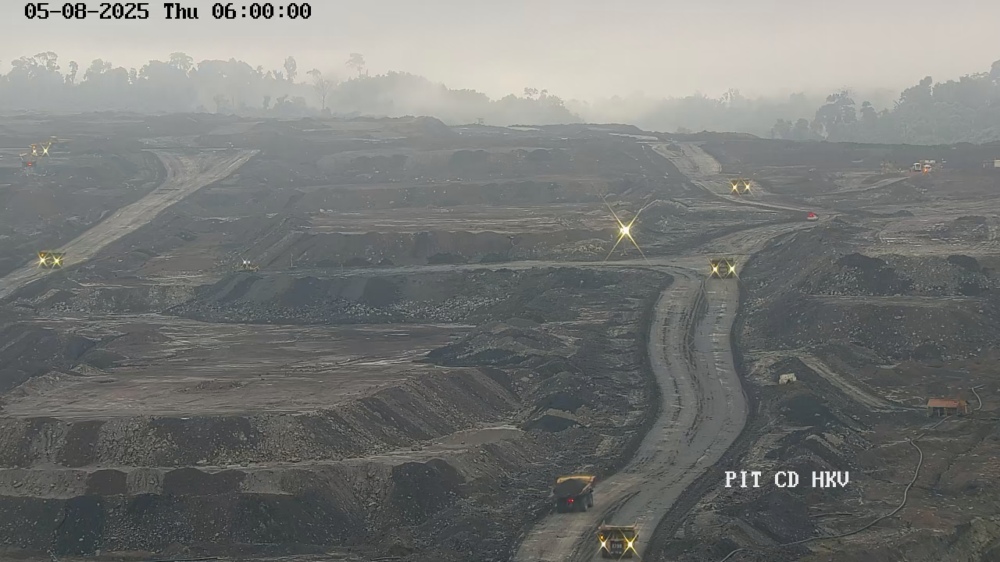

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 06:00:00
  Reference time (T_ref from frame): 06:00:00 (21600s)
  Target Displayed Start (from CSV): 06:06:00 (21960s)
  Target Displayed End (from CSV): 06:06:30 (21990s)
  Calculated FFmpeg start time (-ss): 360 seconds
  Calculated FFmpeg end time (-to): 390 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508060001_20250508065549_776619_TRIM_(19).mp4
FFmpeg command: ffmpeg -ss 358.5 -i /content/drive/MyDrive/Video_bersama/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508060001_20250508065549_776619.mp4 -t 31.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250508060001_20250508065549_776619_TRIM_(19).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBA

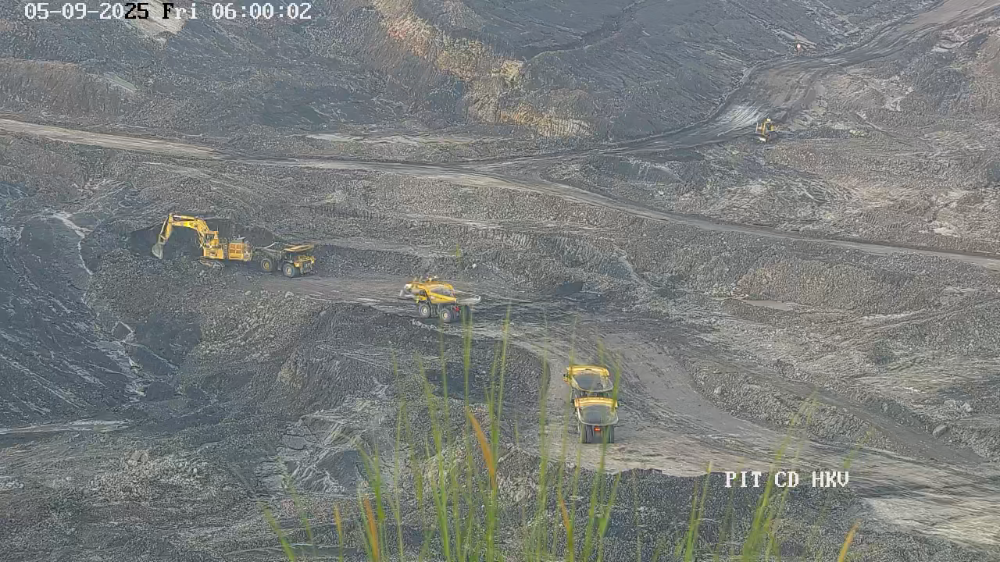

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 06:00:02
  Reference time (T_ref from frame): 06:00:02 (21602s)
  Target Displayed Start (from CSV): 06:12:30 (22350s)
  Target Displayed End (from CSV): 06:12:50 (22370s)
  Calculated FFmpeg start time (-ss): 748 seconds
  Calculated FFmpeg end time (-to): 768 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250509060003_20250509064732_1174166_TRIM_(45).mp4
FFmpeg command: ffmpeg -ss 746.5 -i /content/drive/MyDrive/Video_bersama/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250509060003_20250509064732_1174166.mp4 -t 21.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250509060003_20250509064732_1174166_TRIM_(45).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TA

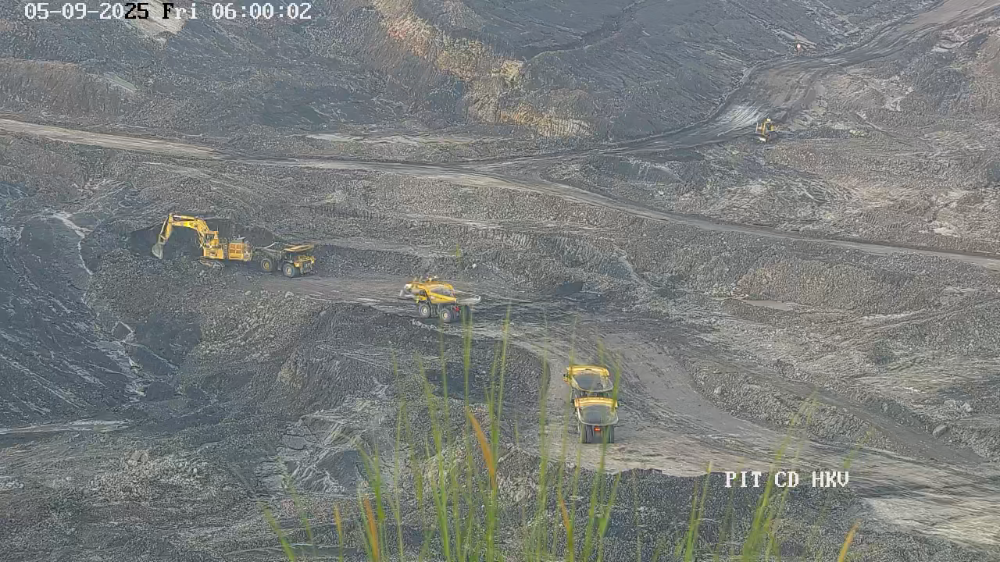

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 06:00:02
  Reference time (T_ref from frame): 06:00:02 (21602s)
  Target Displayed Start (from CSV): 06:04:20 (21860s)
  Target Displayed End (from CSV): 06:04:35 (21875s)
  Calculated FFmpeg start time (-ss): 258 seconds
  Calculated FFmpeg end time (-to): 273 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250509060003_20250509064732_1174166_TRIM_(46).mp4
FFmpeg command: ffmpeg -ss 256.5 -i /content/drive/MyDrive/Video_bersama/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250509060003_20250509064732_1174166.mp4 -t 16.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250509060003_20250509064732_1174166_TRIM_(46).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TA

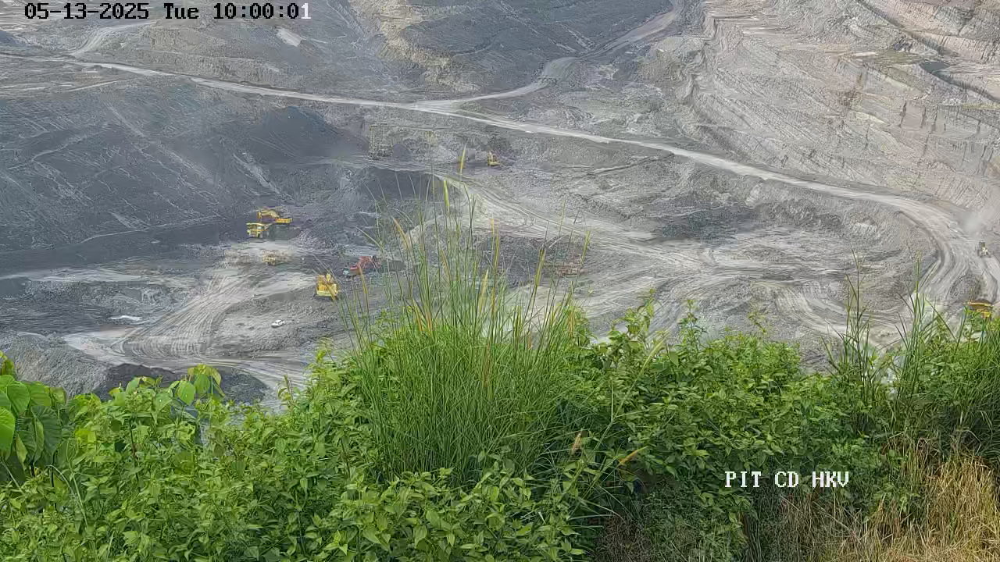

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 10:00:01
  Reference time (T_ref from frame): 10:00:01 (36001s)
  Target Displayed Start (from CSV): 10:41:20 (38480s)
  Target Displayed End (from CSV): 10:41:45 (38505s)
  Calculated FFmpeg start time (-ss): 2479 seconds
  Calculated FFmpeg end time (-to): 2504 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250513100002_20250513122237_1850807_TRIM_(51).mp4
FFmpeg command: ffmpeg -ss 2477.5 -i /content/drive/MyDrive/Video_bersama/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250513100002_20250513122237_1850807.mp4 -t 26.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250513100002_20250513122237_1850807_TRIM_(51).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR

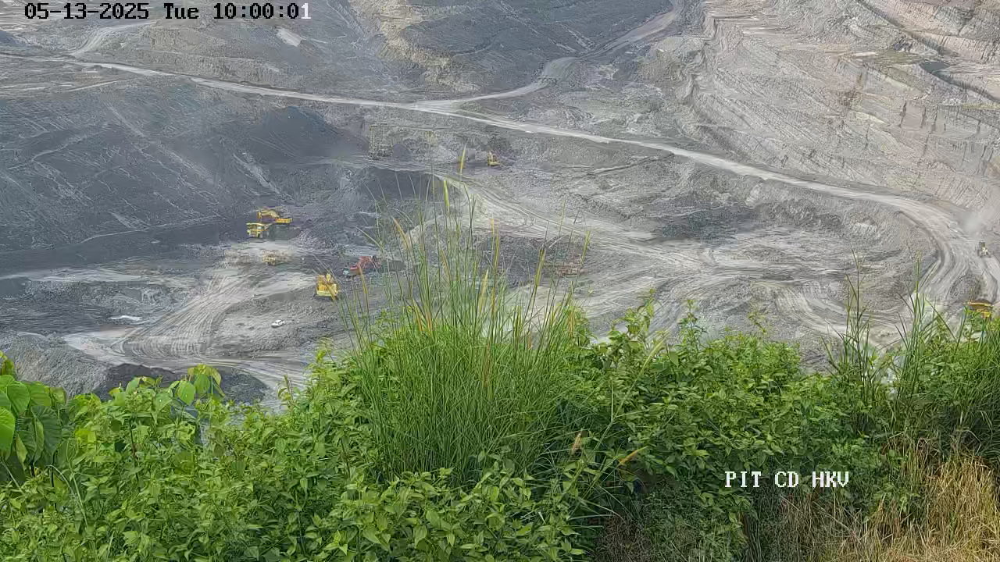

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 10:00:01
  Reference time (T_ref from frame): 10:00:01 (36001s)
  Target Displayed Start (from CSV): 10:40:50 (38450s)
  Target Displayed End (from CSV): 10:41:00 (38460s)
  Calculated FFmpeg start time (-ss): 2449 seconds
  Calculated FFmpeg end time (-to): 2459 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250513100002_20250513122237_1850807_TRIM_(52).mp4
FFmpeg command: ffmpeg -ss 2447.5 -i /content/drive/MyDrive/Video_bersama/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250513100002_20250513122237_1850807.mp4 -t 11.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250513100002_20250513122237_1850807_TRIM_(52).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR

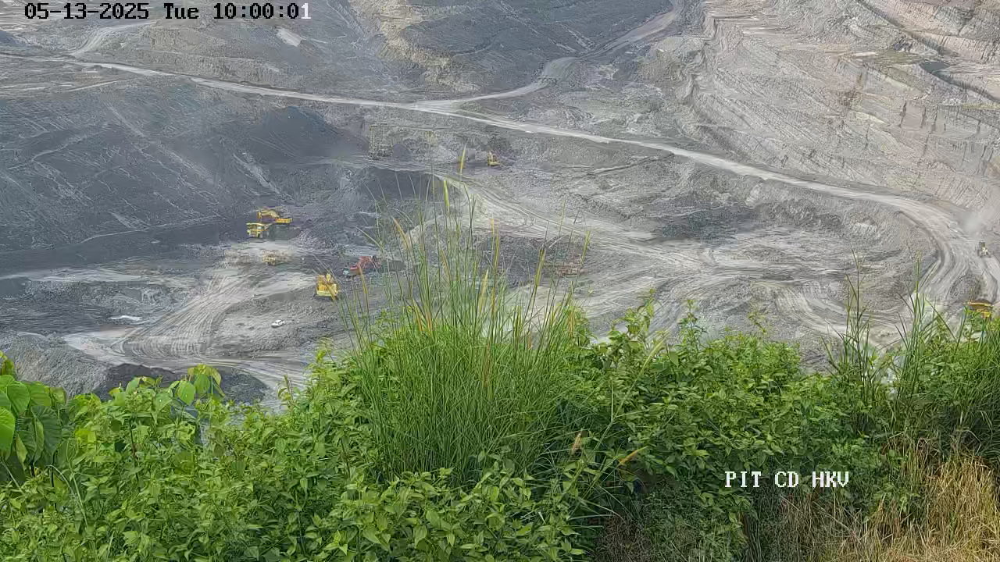

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 10:00:01
  Reference time (T_ref from frame): 10:00:01 (36001s)
  Target Displayed Start (from CSV): 10:18:00 (37080s)
  Target Displayed End (from CSV): 10:18:10 (37090s)
  Calculated FFmpeg start time (-ss): 1079 seconds
  Calculated FFmpeg end time (-to): 1089 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250513100002_20250513122237_1850807_TRIM_(53).mp4
FFmpeg command: ffmpeg -ss 1077.5 -i /content/drive/MyDrive/Video_bersama/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250513100002_20250513122237_1850807.mp4 -t 11.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR_TAMBANG_PIT_CD_20250513100002_20250513122237_1850807_TRIM_(53).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT_CD_HKV_NVR

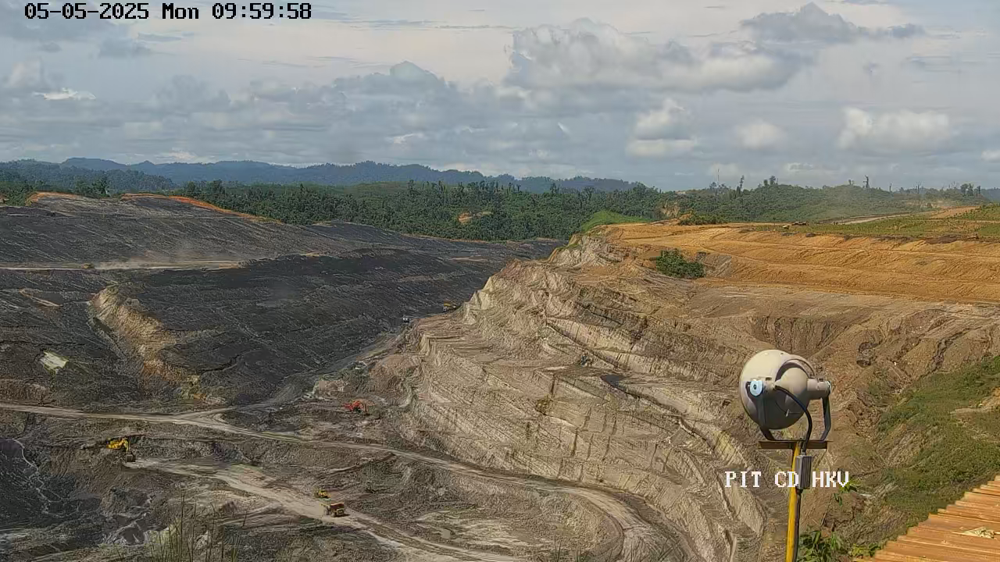

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 09:59:58
  Reference time (T_ref from frame): 09:59:58 (35998s)
  Target Displayed Start (from CSV): 10:53:00 (39180s)
  Target Displayed End (from CSV): 10:53:50 (39230s)
  Calculated FFmpeg start time (-ss): 3182 seconds
  Calculated FFmpeg end time (-to): 3232 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(54).mp4
FFmpeg command: ffmpeg -ss 3180.5 -i /content/drive/MyDrive/Video_bersama/PIT CD HKV_05Mei_10.00-11.00.mp4 -t 51.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(54).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(54).mp4
FFmpeg messages:
 ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmp

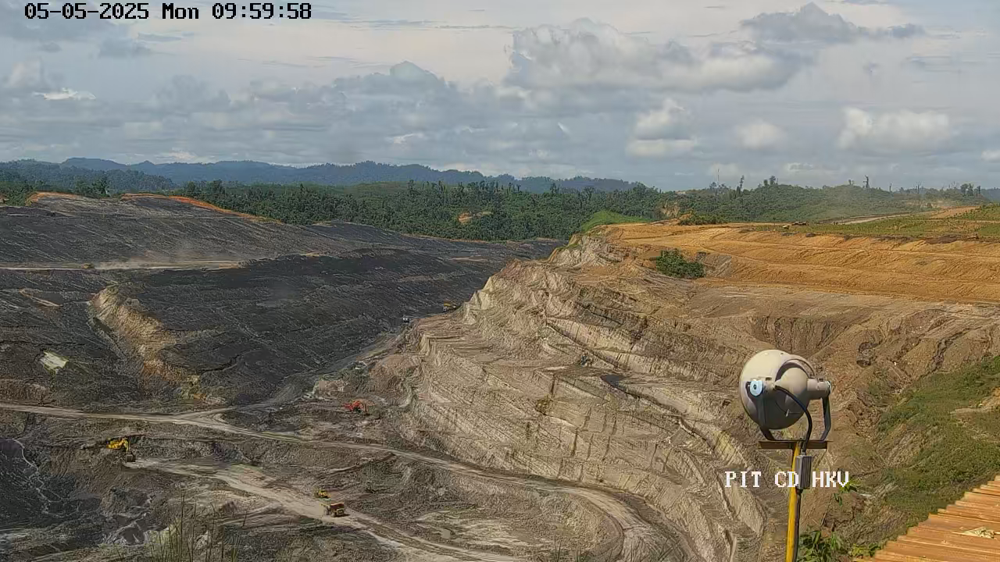

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 09:59:58
  Reference time (T_ref from frame): 09:59:58 (35998s)
  Target Displayed Start (from CSV): 10:51:00 (39060s)
  Target Displayed End (from CSV): 10:52:35 (39155s)
  Calculated FFmpeg start time (-ss): 3062 seconds
  Calculated FFmpeg end time (-to): 3157 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(55).mp4
FFmpeg command: ffmpeg -ss 3060.5 -i /content/drive/MyDrive/Video_bersama/PIT CD HKV_05Mei_10.00-11.00.mp4 -t 96.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(55).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(55).mp4
FFmpeg messages:
 ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmp

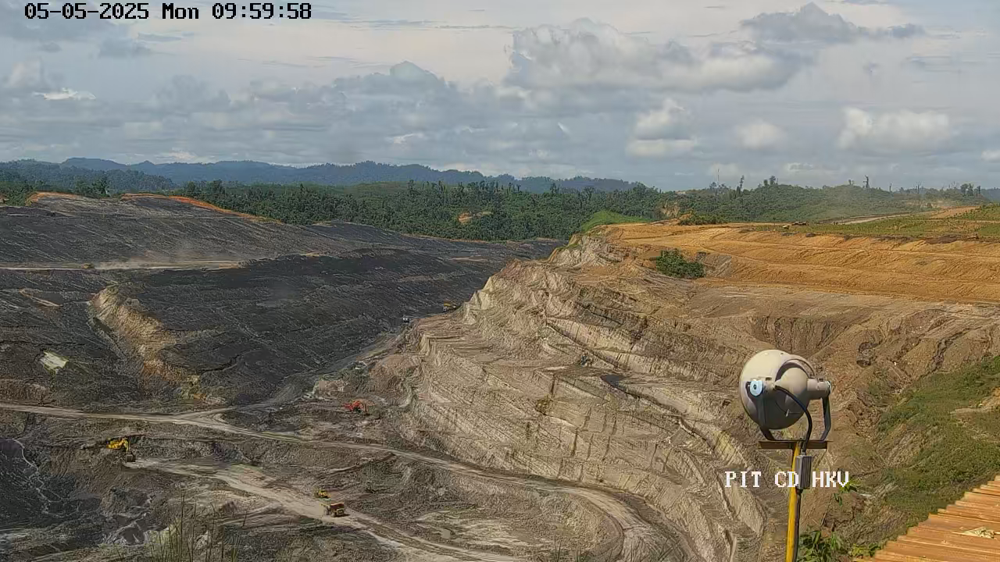

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 09:59:58
  Reference time (T_ref from frame): 09:59:58 (35998s)
  Target Displayed Start (from CSV): 10:51:00 (39060s)
  Target Displayed End (from CSV): 10:52:35 (39155s)
  Calculated FFmpeg start time (-ss): 3062 seconds
  Calculated FFmpeg end time (-to): 3157 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(56).mp4
FFmpeg command: ffmpeg -ss 3060.5 -i /content/drive/MyDrive/Video_bersama/PIT CD HKV_05Mei_10.00-11.00.mp4 -t 96.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(56).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(56).mp4
FFmpeg messages:
 ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmp

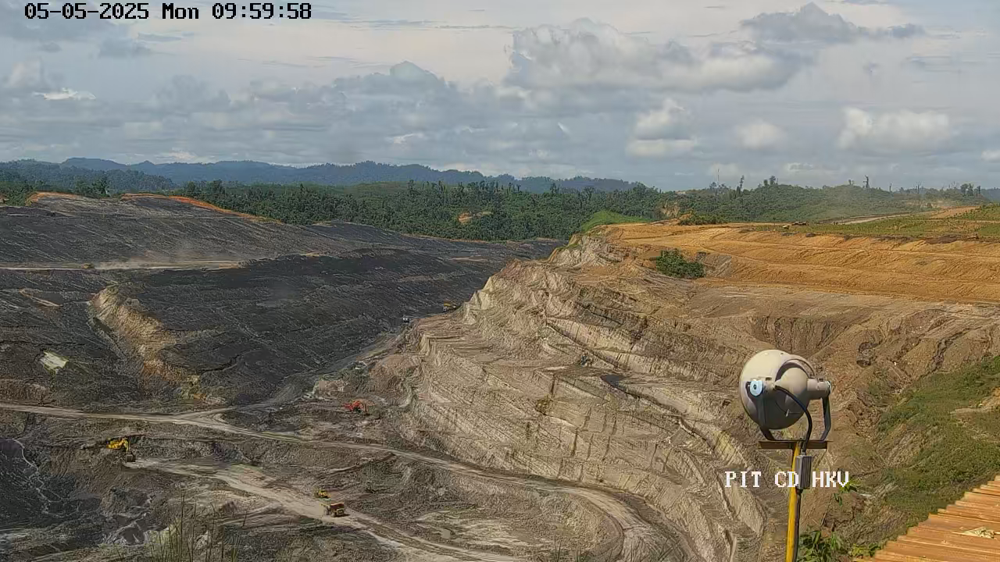

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 09:59:58
  Reference time (T_ref from frame): 09:59:58 (35998s)
  Target Displayed Start (from CSV): 10:53:00 (39180s)
  Target Displayed End (from CSV): 10:53:50 (39230s)
  Calculated FFmpeg start time (-ss): 3182 seconds
  Calculated FFmpeg end time (-to): 3232 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(57).mp4
FFmpeg command: ffmpeg -ss 3180.5 -i /content/drive/MyDrive/Video_bersama/PIT CD HKV_05Mei_10.00-11.00.mp4 -t 51.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(57).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(57).mp4
FFmpeg messages:
 ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmp

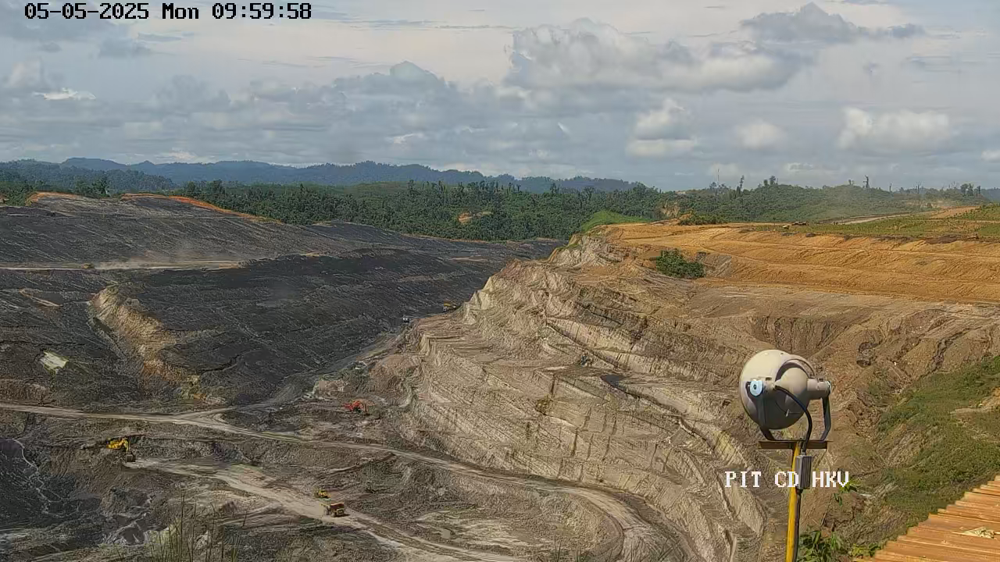

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
  Reference time (T_ref from frame): 09:59:58 (35998s)
  Target Displayed Start (from CSV): 10:51:00 (39060s)
  Target Displayed End (from CSV): 10:52:35 (39155s)
  Calculated FFmpeg start time (-ss): 3062 seconds
  Calculated FFmpeg end time (-to): 3157 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(58).mp4
FFmpeg command: ffmpeg -ss 3060.5 -i /content/drive/MyDrive/Video_bersama/PIT CD HKV_05Mei_10.00-11.00.mp4 -t 96.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(58).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(58).mp4
FFmpeg messages:
 ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)


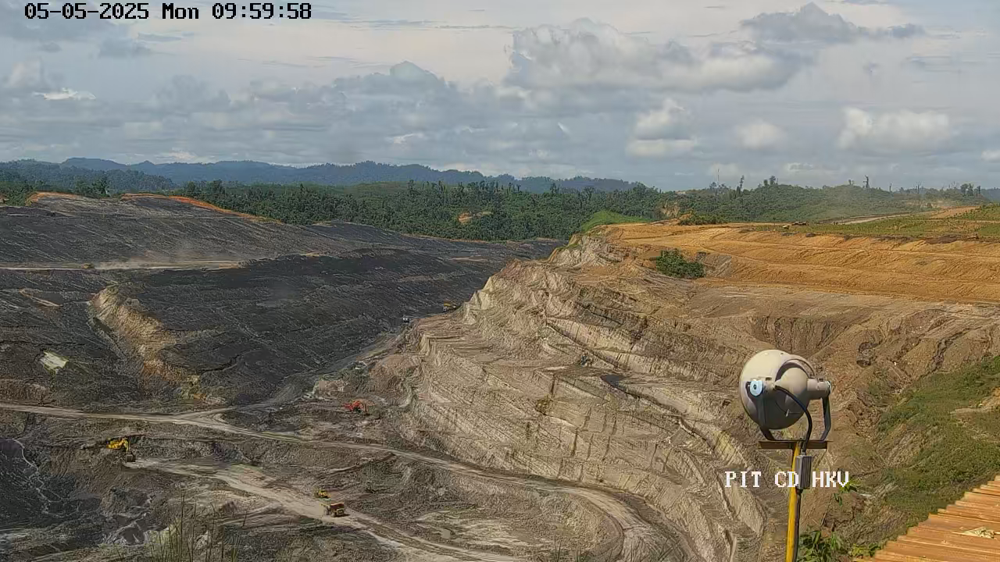

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 09:59:58
  Reference time (T_ref from frame): 09:59:58 (35998s)
  Target Displayed Start (from CSV): 10:51:00 (39060s)
  Target Displayed End (from CSV): 10:52:35 (39155s)
  Calculated FFmpeg start time (-ss): 3062 seconds
  Calculated FFmpeg end time (-to): 3157 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(59).mp4
FFmpeg command: ffmpeg -ss 3060.5 -i /content/drive/MyDrive/Video_bersama/PIT CD HKV_05Mei_10.00-11.00.mp4 -t 96.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(59).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(59).mp4
FFmpeg messages:
 ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmp

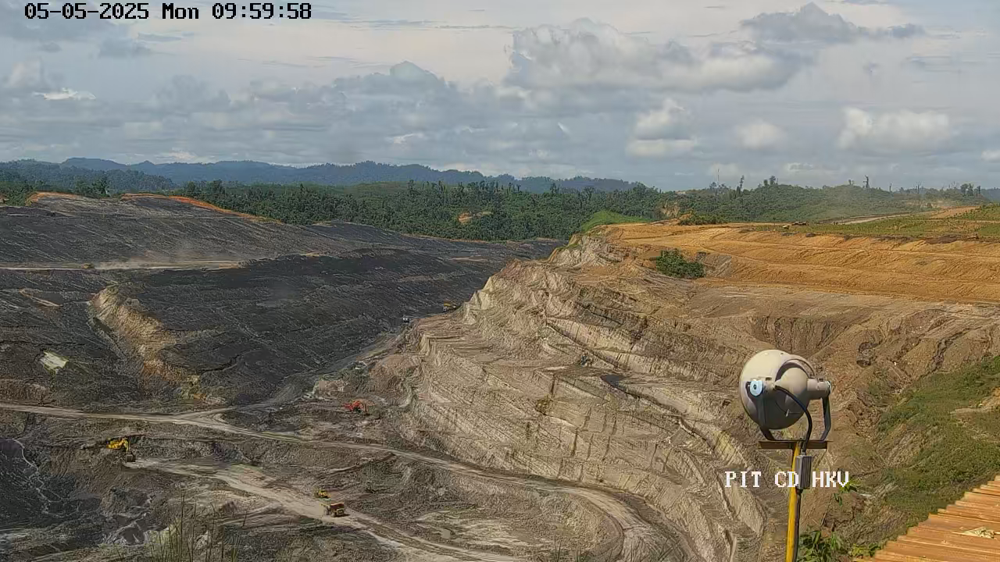

^^^ --- First Frame of the Video --- ^^^

DEBUG: About to ask for timestamp input. Please check for the input field below.
Enter the (HH:MM:SS) visible on THIS first frame : 09:59:58
  Reference time (T_ref from frame): 09:59:58 (35998s)
  Target Displayed Start (from CSV): 10:51:00 (39060s)
  Target Displayed End (from CSV): 10:52:35 (39155s)
  Calculated FFmpeg start time (-ss): 3062 seconds
  Calculated FFmpeg end time (-to): 3157 seconds
Attempting to trim. Output will be: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(60).mp4
FFmpeg command: ffmpeg -ss 3060.5 -i /content/drive/MyDrive/Video_bersama/PIT CD HKV_05Mei_10.00-11.00.mp4 -t 96.5 -c copy /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(60).mp4 -y
Successfully trimmed video saved to: /content/drive/MyDrive/Trimmed_Videos_Firdaus/PIT CD HKV_05Mei_10.00-11.00_TRIM_(60).mp4
FFmpeg messages:
 ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmp

In [53]:
# Cell 4: Main Processing Loop for "Firdaus" Tasks
import subprocess
import os
from IPython.display import clear_output # To clear previous frame display

DRIVE_SEARCH_PATH = "/content/drive/MyDrive/Video_bersama"

TRIMMED_VIDEOS_OUTPUT_DIR = "/content/drive/MyDrive/Trimmed_Videos_Firdaus"
os.makedirs(TRIMMED_VIDEOS_OUTPUT_DIR, exist_ok=True)
print(f"Trimmed videos will be saved to: {TRIMMED_VIDEOS_OUTPUT_DIR}")


if 'firdaus_tasks_df' not in locals() or firdaus_tasks_df.empty:
    print("No tasks for 'Firdaus' to process. Please run Cell 2 first.")
else:
    print(f"\nStarting processing for {len(firdaus_tasks_df)} 'Firdaus' tasks...\n")
    processed_count = 0
    failed_count = 0

    for index, row in firdaus_tasks_df.iterrows():
        video_filename_from_csv = row['Link Video Magang'].strip() # From CSV
        timestamp_string_from_csv = row['Timestamp'].strip()      # From CSV

        print(f"--- Processing Task {index + 1} ---")
        print(f"Video Filename (from CSV): {video_filename_from_csv}")
        print(f"Timestamp String (from CSV): {timestamp_string_from_csv}")

        # 1. Locate the video file in Google Drive
        actual_video_path = find_file_in_drive(video_filename_from_csv, DRIVE_SEARCH_PATH)

        if not actual_video_path:
            print(f"Skipping task for '{video_filename_from_csv}' as it was not found in Drive.\n")
            failed_count += 1
            continue

        # 2. Extract and display the first frame
        temp_frame_image_path = extract_first_frame_from_video(actual_video_path)
        if not temp_frame_image_path:
            print(f"Skipping task for '{video_filename_from_csv}' due to error extracting first frame.\n")
            failed_count += 1
            continue

        #clear_output(wait=True) # Clear previous outputs before showing new frame/prompt
        print(f"--- Processing Task {index + 1} for {video_filename_from_csv} ---")
        print(f"Video found at: {actual_video_path}")
        print(f"Target displayed times from CSV: {timestamp_string_from_csv}")
        print("\nVVV --- First Frame of the Video --- VVV")
        display(Image(filename=temp_frame_image_path, width=400))
        print("^^^ --- First Frame of the Video --- ^^^")

        # 3. Prompt user for the reference timestamp (T_ref) from the displayed frame
        t_ref_input_str = ""
        while True:
            print("\nDEBUG: About to ask for timestamp input. Please check for the input field below.") # New debug print
            time.sleep(0.5) # New: wait for half a second
            #add width of input
            t_ref_input_str = input(f"Enter the (HH:MM:SS) visible on THIS first frame : ")
            if t_ref_input_str.lower() == 'skip':
                break
            if time_to_seconds(t_ref_input_str) is not None: # Basic validation
                break
            else:
                print("Invalid format. Please use HH:MM:SS (e.g., 06:58:38).")

        if t_ref_input_str.lower() == 'skip':
            print(f"Skipping task for '{video_filename_from_csv}' by user request.\n")
            failed_count += 1
            # Optionally remove the temp frame
            if os.path.exists(temp_frame_image_path):
                os.remove(temp_frame_image_path)
            continue

        # 4. Parse target timestamps from CSV
        try:
            t_target_start_str, t_target_end_str = timestamp_string_from_csv.lower().split(' sd ')
            t_target_start_str = t_target_start_str.strip()
            t_target_end_str = t_target_end_str.strip()
        except ValueError:
            print(f"Error: Timestamp format in CSV ('{timestamp_string_from_csv}') is incorrect. Expected 'HH:MM:SS sd HH:MM:SS'. Skipping.")
            failed_count += 1
            continue

        # 5. Convert all times to seconds and calculate playback times
        t_ref_seconds = time_to_seconds(t_ref_input_str)
        t_target_start_seconds = time_to_seconds(t_target_start_str)
        t_target_end_seconds = time_to_seconds(t_target_end_str)

        if None in [t_ref_seconds, t_target_start_seconds, t_target_end_seconds]:
            print("Error in time conversion for one of the timestamps. Skipping.\n")
            failed_count += 1
            continue

        playback_start_cut_seconds = t_target_start_seconds - t_ref_seconds
        playback_end_cut_seconds = t_target_end_seconds - t_ref_seconds

        print(f"  Reference time (T_ref from frame): {t_ref_input_str} ({t_ref_seconds}s)")
        print(f"  Target Displayed Start (from CSV): {t_target_start_str} ({t_target_start_seconds}s)")
        print(f"  Target Displayed End (from CSV): {t_target_end_str} ({t_target_end_seconds}s)")
        print(f"  Calculated FFmpeg start time (-ss): {playback_start_cut_seconds} seconds")
        print(f"  Calculated FFmpeg end time (-to): {playback_end_cut_seconds} seconds")

        # 6. Validate and Perform Trim
        if playback_start_cut_seconds < 0:
            print("Error: Calculated trim times are invalid (e.g., start < 0 or end <= start). Skipping.\n")
            failed_count += 1
            continue

        playback_start_cut_seconds_adjusted = max(0, playback_start_cut_seconds - 1.5) # Start 0.2s earlier
        duration_seconds = playback_end_cut_seconds - playback_start_cut_seconds_adjusted
        if duration_seconds <= 0:
            print(f"Error: Calculated duration ({duration_seconds}s) is not positive. Target end time might be before or at start time. Skipping.\n")
            failed_count += 1
            continue

        base, orig_ext = os.path.splitext(video_filename_from_csv)

        try:
            task_no = str(row['No']).strip() # Ambil nomor tugas, ubah ke string, dan hapus spasi
            if not task_no: # Jika task_no kosong setelah strip
                print("Warning: Nilai pada kolom 'No' kosong. Menggunakan index baris sebagai fallback.")
                task_no = str(index) # index dari iterrows()
        except KeyError:
            print("Warning: Kolom 'No' tidak ditemukan di baris CSV. Menggunakan index baris sebagai fallback.")
            task_no = str(index) # Fallback ke index DataFrame jika kolom 'No' tidak ada

        output_trimmed_video_name = f"{base}_TRIM_({task_no}).mp4"

        output_trimmed_video_name = output_trimmed_video_name.replace("/", "_").replace("\\", "_").replace(":", "-")

        full_output_path = os.path.join(TRIMMED_VIDEOS_OUTPUT_DIR, output_trimmed_video_name)

        trim_command = [
        'ffmpeg',
        '-ss', str(playback_start_cut_seconds_adjusted),
        '-i', actual_video_path,
        '-t', str(duration_seconds),
        '-c', 'copy',
        full_output_path,
        '-y'
        ]

        print(f"Attempting to trim. Output will be: {full_output_path}")
        print(f"FFmpeg command: {' '.join(trim_command)}")
        try:
            result = subprocess.run(trim_command, check=True, capture_output=True, text=True)
            print(f"Successfully trimmed video saved to: {full_output_path}")
            if result.stderr:
                print("FFmpeg messages:\n", result.stderr)
            processed_count += 1
        except subprocess.CalledProcessError as e:
            print(f"Error during FFmpeg trimming for '{video_filename_from_csv}':\n{e.stderr}\n")
            failed_count += 1

        # Clean up temp frame
        if os.path.exists(temp_frame_image_path):
            os.remove(temp_frame_image_path)
        print("--- Task Complete ---\n")

    print(f"\n--- Overall Processing Summary ---")
    print(f"Total tasks for Firdaus: {len(firdaus_tasks_df)}")
    print(f"Successfully processed and trimmed: {processed_count}")
    print(f"Failed or skipped: {failed_count}")